In [1]:
# Install required packages
!pip install kafka-python --quiet
!pip install pandas --quiet
!pip install pyspark --quiet
!pip install matplotlib seaborn plotly --quiet

In [8]:
import pandas as pd

# Try reading the file with a different encoding, e.g., 'latin-1' or 'cp1252'
# Specify the number of columns expected using the 'names' argument
# and handle errors with 'error_bad_lines' and 'warn_bad_lines'
df = pd.read_csv("/content/drive/MyDrive/data/movie_titles.csv",
                 encoding='latin-1',
                 names=['movie_id', 'year', 'movie_name'], # Replace with actual column names if known
                 on_bad_lines='warn', # or 'skip' to skip bad lines
                 index_col=False)
# If 'latin-1' doesn't work, try 'cp1252' or other encodings

# Convert 'year' column to integers, handling potential errors
df['year'] = pd.to_numeric(df['year'], errors='coerce').astype('Int64')

df.head()

<ipython-input-8-4ec58fa03411>:6: ParserWarning: Length of header or names does not match length of data. This leads to a loss of data with index_col=False.
  df = pd.read_csv("/content/drive/MyDrive/data/movie_titles.csv",


,movie_id,year,movie_name
0,1,2003,Dinosaur Planet
1,2,2004,Isle of Man TT 2004 Review
2,3,1997,Character
3,4,1994,Paula Abdul's Get Up & Dance
4,5,2004,The Rise and Fall of ECW


In [ ]:
df = pd.read_csv("/content/drive/MyDrive/data/combined_data_1.txt", delimiter="\t")
df.head()

,1:
0,"1488844,3,2005-09-06"
1,"822109,5,2005-05-13"
2,"885013,4,2005-10-19"
3,"30878,4,2005-12-26"
4,"823519,3,2004-05-03"


Processing movie titles...


<ipython-input-2-3f6671fd3d99>:22: ParserWarning: Length of header or names does not match length of data. This leads to a loss of data with index_col=False.
  self.movies_df = pd.read_csv(



Movie Dataset Statistics:
-------------------------
Total Movies: 17770
Movies with Valid Years: 17763
Movies Missing Years: 7
Year Range: {'Earliest': 1896, 'Latest': 2005}
Movies per Decade: {'1890s': 1, '1900s': 1, '1910s': 24, '1920s': 81, '1930s': 219, '1940s': 359, '1950s': 561, '1960s': 952, '1970s': 1309, '1980s': 2136, '1990s': 5173, '2000s': 6947}

Processing ratings data...

Combined Dataset Statistics:
--------------------------
Total Movies: 4499
Total Customers: 470758
Total Ratings: 24053764
Rating Distribution: {1: 1118186, 2: 2439073, 3: 6904181, 4: 8085741, 5: 5506583}
Average Rating: 3.6
Date Range: {'Start': '1999-11-11', 'End': '2005-12-31'}

Top Rated Movies:
----------------
Lost: Season 1 (2004) - Average Rating: 4.67 (7249 ratings)
Ghost in the Shell: Stand Alone Complex: 2nd Gig (2005) - Average Rating: 4.59 (220 ratings)
The Simpsons: Season 6 (1994) - Average Rating: 4.58 (8426 ratings)
Inu-Yasha (2000) - Average Rating: 4.55 (1883 ratings)
Lord of the Ring

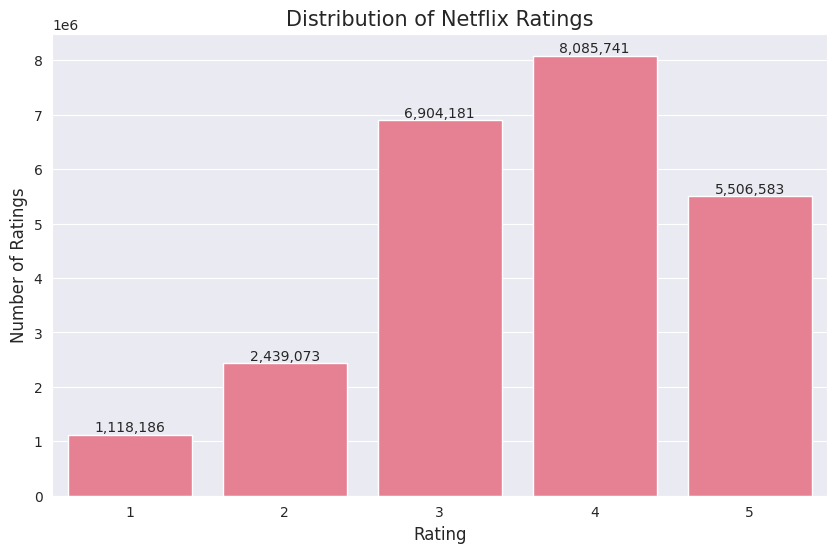

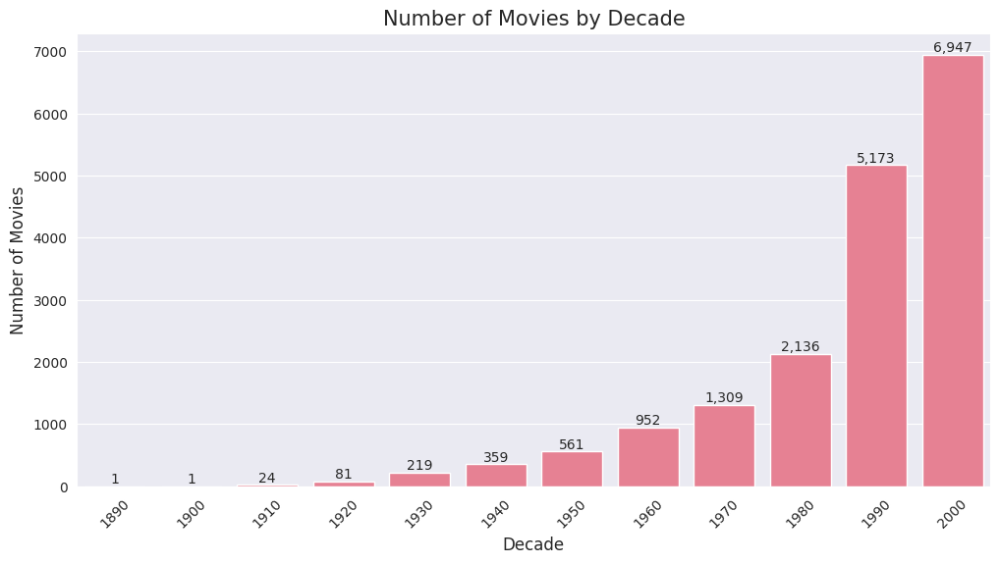

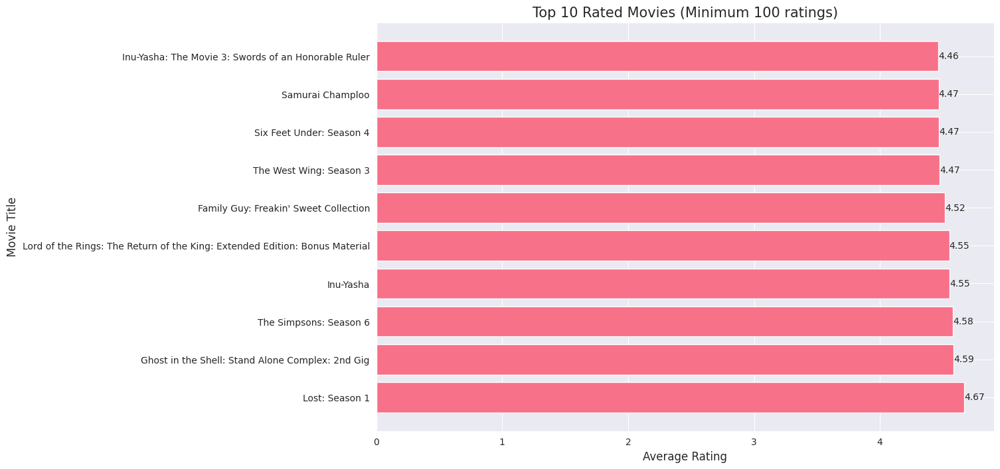

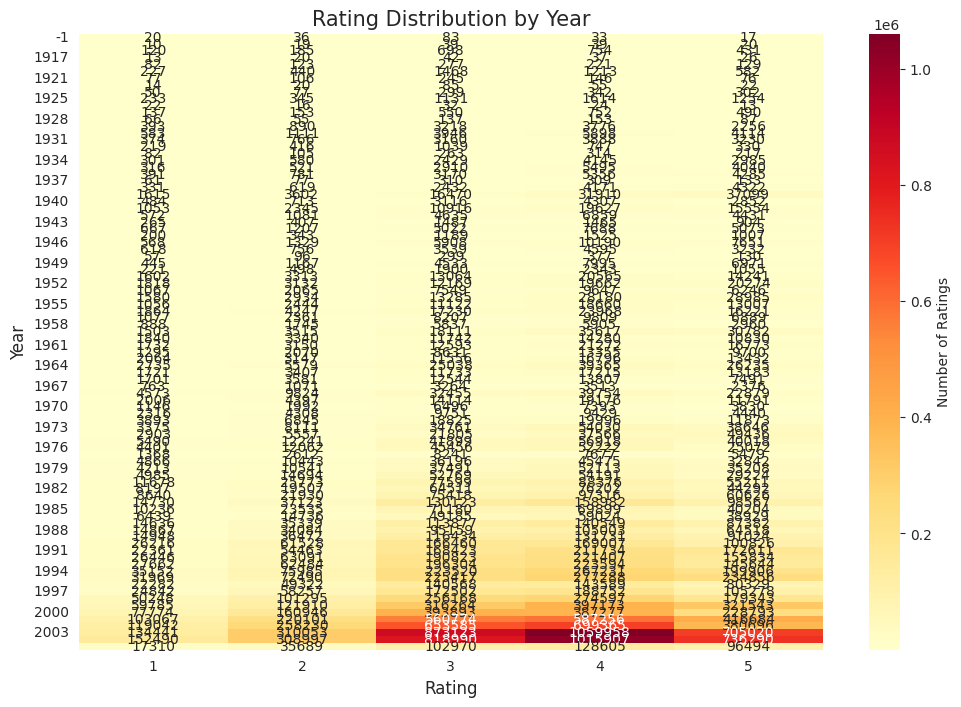

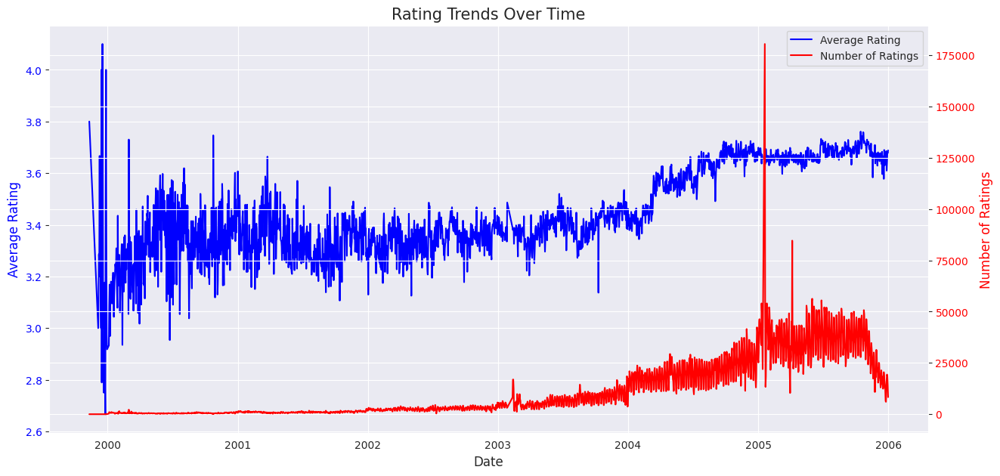


Creating interactive plots...



Exported processed data to 'processed_netflix_data.csv'


In [2]:
import pandas as pd
import numpy as np
from datetime import datetime
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import os
class NetflixDataProcessor:
    def __init__(self):
        self.movies_df = None
        self.ratings_df = None
        self.merged_df = None

    def process_movie_titles(self, movie_titles_file):
        """
        Process the movie titles CSV file
        Format: MovieID,YearOfRelease,Title
        """
        try:
            # Read movie titles CSV with modified dtype settings
            self.movies_df = pd.read_csv(
                movie_titles_file,
                encoding='latin-1',
                header=None,  # Specify no header
                names=['MovieID', 'Year', 'Title'],
                index_col=False,
                dtype={
                    'MovieID': 'Int64',  # Using Int64 to handle missing values
                    'Year': 'Int64',    # Read year as string first
                    'Title': 'string'
                },
                na_values=['', 'NULL', 'nan', 'NaN'],  # Additional NA values
                keep_default_na=True
            )

            # Clean and convert the Year column
            self.movies_df['Year'] = pd.to_numeric(self.movies_df['Year'], errors='coerce').astype('Int64')


            # Fill missing values
            self.movies_df['Title'] = self.movies_df['Title'].fillna('Unknown')
            self.movies_df['Year'] = self.movies_df['Year'].fillna(-1)  # Use -1 for unknown years

            # Convert Year to integer where valid
            self.movies_df['Year'] = self.movies_df['Year'].astype('Int64')

            # Create statistics excluding invalid years
            valid_years = self.movies_df[self.movies_df['Year'] > 0]['Year']

            return {
                'Total Movies': len(self.movies_df),
                'Movies with Valid Years': len(valid_years),
                'Movies Missing Years': len(self.movies_df[self.movies_df['Year'] <= 0]),
                'Year Range': {
                    'Earliest': int(valid_years.min()),
                    'Latest': int(valid_years.max())
                },
                'Movies per Decade': self.get_movies_per_decade()
            }

        except Exception as e:
            print(f"Error processing movie titles: {str(e)}")
            raise

    def get_movies_per_decade(self):
        """
        Calculate number of movies per decade
        """
        if self.movies_df is None:
            return None

        # Only consider valid years
        valid_movies = self.movies_df[self.movies_df['Year'] > 0].copy()
        valid_movies['Decade'] = (valid_movies['Year'] // 10) * 10
        decades = valid_movies['Decade'].value_counts().sort_index().to_dict()
        return {f"{decade}s": count for decade, count in decades.items()}

    def process_ratings_data(self, content):
        """
        Process the ratings data from the raw content
        """
        # Initialize lists to store data
        movie_ids = []
        customer_ids = []
        ratings = []
        dates = []

        current_movie_id = None

        # Process each line
        for line in content.split('\n'):
            line = line.strip()
            if not line:
                continue

            # Check if line contains movie ID
            if line.endswith(':'):
                try:
                    current_movie_id = int(line[:-1])
                except ValueError:
                    continue
                continue

            # Process rating data
            try:
                customer_id, rating, date = line.split(',')
                movie_ids.append(current_movie_id)
                customer_ids.append(int(customer_id))
                ratings.append(int(rating))
                dates.append(date)
            except (ValueError, TypeError, AttributeError):
                continue

        # Create DataFrame
        self.ratings_df = pd.DataFrame({
            'MovieID': movie_ids,
            'CustomerID': customer_ids,
            'Rating': ratings,
            'Date': dates
        })

        # Merge with movie titles if available
        self.merge_data()

        # Calculate statistics
        stats = self.calculate_statistics()
        return stats

    def merge_data(self):
        """
        Merge ratings data with movie titles
        """
        if self.ratings_df is None or self.movies_df is None:
            return

        self.merged_df = pd.merge(
            self.ratings_df,
            self.movies_df,
            on='MovieID',
            how='left'
        )

        # Handle missing values after merge
        self.merged_df['Title'] = self.merged_df['Title'].fillna('Unknown Movie')
        self.merged_df['Year'] = self.merged_df['Year'].fillna(-1)

        # Reorder columns
        self.merged_df = self.merged_df[[
            'MovieID','CustomerID', 'Title', 'Year', 'Rating', 'Date'
        ]]

    def calculate_statistics(self):
        """
        Calculate various statistics about the dataset
        """
        if self.merged_df is None:
            return None

        stats = {
            'Total Movies': self.merged_df['MovieID'].nunique(),
            'Total Customers': self.merged_df['CustomerID'].nunique(),
            'Total Ratings': len(self.merged_df),
            'Rating Distribution': self.merged_df['Rating'].value_counts().sort_index().to_dict(),
            'Average Rating': round(self.merged_df['Rating'].mean(), 2),
            'Date Range': {
                'Start': self.merged_df['Date'].min(),
                'End': self.merged_df['Date'].max()
            },
            'Top Rated Movies': self.get_top_rated_movies(10)
        }
        return stats

    def get_top_rated_movies(self, n=10, min_ratings=100):
        """
        Get top rated movies with a minimum number of ratings
        """
        if self.merged_df is None:
            return None

        # Calculate average rating and rating count per movie
        movie_stats = self.merged_df.groupby(['MovieID', 'Title', 'Year']).agg({
            'Rating': ['count', 'mean']
        }).reset_index()

        # Flatten column names
        movie_stats.columns = ['MovieID', 'Title', 'Year', 'NumRatings', 'AvgRating']

        # Filter and sort
        top_movies = movie_stats[
            (movie_stats['NumRatings'] >= min_ratings) &
            (movie_stats['Year'] > 0)  # Only include movies with valid years
        ].sort_values('AvgRating', ascending=False).head(n)

        return top_movies.to_dict('records')

    def export_to_csv(self, filename):
        """
        Export processed data to CSV file
        """
        if self.merged_df is not None:
            self.merged_df.to_csv(filename, index=False)
            return True
        return False



    def create_visualizations(self, save_dir=None):
        """
        Create and display various visualizations of the Netflix dataset
        """
        if self.merged_df is None:
            print("No data available for visualization")
            return

        if save_dir:
            os.makedirs(save_dir, exist_ok=True)

        # Set the style for all plots
        sns.set_style('darkgrid')
        sns.set_palette("husl")

        # 1. Ratings Distribution
        self._plot_ratings_distribution(save_dir)

        # 2. Movies per Decade
        self._plot_movies_per_decade(save_dir)

        # 3. Top Rated Movies
        self._plot_top_rated_movies(save_dir)

        # 4. Ratings Heatmap
        self._plot_ratings_heatmap(save_dir)

        # 5. Rating Trends Over Time
        self._plot_rating_trends(save_dir)

    def _plot_ratings_distribution(self, save_dir=None):
        """Plot distribution of ratings"""
        plt.figure(figsize=(10, 6))

        # Create rating distribution plot
        sns.countplot(data=self.merged_df, x='Rating', order=range(1, 6))

        # Customize plot
        plt.title('Distribution of Netflix Ratings', fontsize=15)
        plt.xlabel('Rating', fontsize=12)
        plt.ylabel('Number of Ratings', fontsize=12)

        # Add value labels on top of bars
        for i in plt.gca().containers[0]:
            plt.text(i.get_x() + i.get_width()/2,
                    i.get_height(),
                    f'{int(i.get_height()):,}',
                    ha='center', va='bottom')

        if save_dir:
            plt.savefig(f'{save_dir}/ratings_distribution.png', bbox_inches='tight')
        plt.show()

    def _plot_movies_per_decade(self, save_dir=None):
        """Plot number of movies per decade"""
        valid_movies = self.movies_df[self.movies_df['Year'] > 0].copy()
        valid_movies['Decade'] = (valid_movies['Year'] // 10) * 10

        plt.figure(figsize=(12, 6))

        # Create decade distribution plot
        decade_counts = valid_movies['Decade'].value_counts().sort_index()
        ax = sns.barplot(x=decade_counts.index.astype(str), y=decade_counts.values)

        # Customize plot
        plt.title('Number of Movies by Decade', fontsize=15)
        plt.xlabel('Decade', fontsize=12)
        plt.ylabel('Number of Movies', fontsize=12)
        plt.xticks(rotation=45)

        # Add value labels
        for i, v in enumerate(decade_counts.values):
            ax.text(i, v, f'{int(v):,}', ha='center', va='bottom')

        if save_dir:
            plt.savefig(f'{save_dir}/movies_per_decade.png', bbox_inches='tight')
        plt.show()

    def _plot_top_rated_movies(self, save_dir=None, n=10, min_ratings=100):
        """Plot top rated movies"""
        top_movies = self.get_top_rated_movies(n, min_ratings)

        plt.figure(figsize=(12, 8))

        # Create horizontal bar plot
        movies_df = pd.DataFrame(top_movies)
        bars = plt.barh(movies_df['Title'], movies_df['AvgRating'])

        # Customize plot
        plt.title(f'Top {n} Rated Movies (Minimum {min_ratings} ratings)', fontsize=15)
        plt.xlabel('Average Rating', fontsize=12)
        plt.ylabel('Movie Title', fontsize=12)

        # Add value labels
        for bar in bars:
            width = bar.get_width()
            plt.text(width, bar.get_y() + bar.get_height()/2,
                    f'{width:.2f}',
                    ha='left', va='center')

        if save_dir:
            plt.savefig(f'{save_dir}/top_rated_movies.png', bbox_inches='tight')
        plt.show()

    def _plot_ratings_heatmap(self, save_dir=None):
        """Create a heatmap of ratings by year"""
        # Prepare data for heatmap
        heatmap_data = pd.crosstab(
            self.merged_df['Year'],
            self.merged_df['Rating']
        )

        plt.figure(figsize=(12, 8))

        # Create heatmap
        sns.heatmap(heatmap_data,
                   cmap='YlOrRd',
                   annot=True,
                   fmt='d',
                   cbar_kws={'label': 'Number of Ratings'})

        # Customize plot
        plt.title('Rating Distribution by Year', fontsize=15)
        plt.xlabel('Rating', fontsize=12)
        plt.ylabel('Year', fontsize=12)

        if save_dir:
            plt.savefig(f'{save_dir}/ratings_heatmap.png', bbox_inches='tight')
        plt.show()

    def _plot_rating_trends(self, save_dir=None):
        """Plot rating trends over time"""
        # Prepare data
        self.merged_df['Date'] = pd.to_datetime(self.merged_df['Date'])
        daily_stats = self.merged_df.groupby('Date').agg({
            'Rating': ['mean', 'count']
        }).reset_index()
        daily_stats.columns = ['Date', 'AvgRating', 'NumRatings']

        # Create figure with dual axes
        fig, ax1 = plt.subplots(figsize=(15, 7))
        ax2 = ax1.twinx()

        # Plot average rating
        line1 = ax1.plot(daily_stats['Date'],
                        daily_stats['AvgRating'],
                        'b-',
                        label='Average Rating')
        ax1.set_xlabel('Date', fontsize=12)
        ax1.set_ylabel('Average Rating', color='b', fontsize=12)
        ax1.tick_params(axis='y', labelcolor='b')

        # Plot number of ratings
        line2 = ax2.plot(daily_stats['Date'],
                        daily_stats['NumRatings'],
                        'r-',
                        label='Number of Ratings')
        ax2.set_ylabel('Number of Ratings', color='r', fontsize=12)
        ax2.tick_params(axis='y', labelcolor='r')

        # Add legend
        lines = line1 + line2
        labels = [l.get_label() for l in lines]
        plt.legend(lines, labels, loc='upper right')

        plt.title('Rating Trends Over Time', fontsize=15)

        if save_dir:
            plt.savefig(f'{save_dir}/rating_trends.png', bbox_inches='tight')
        plt.show()

    def create_interactive_plots(self):
        """Create interactive plots using plotly"""
        # 1. Interactive Rating Distribution
        fig1 = px.histogram(self.merged_df, x='Rating',
                          title='Interactive Rating Distribution',
                          labels={'Rating': 'Rating Value', 'count': 'Number of Ratings'})
        fig1.show()

        # 2. Interactive Rating Trends
        daily_stats = self.merged_df.groupby('Date').agg({
            'Rating': ['mean', 'count']
        }).reset_index()
        daily_stats.columns = ['Date', 'AvgRating', 'NumRatings']

        fig2 = go.Figure()
        fig2.add_trace(go.Scatter(x=daily_stats['Date'],
                                y=daily_stats['AvgRating'],
                                name='Average Rating'))
        fig2.add_trace(go.Scatter(x=daily_stats['Date'],
                                y=daily_stats['NumRatings'],
                                name='Number of Ratings',
                                yaxis='y2'))

        fig2.update_layout(
            title='Interactive Rating Trends Over Time',
            yaxis=dict(title='Average Rating'),
            yaxis2=dict(title='Number of Ratings', overlaying='y', side='right')
        )
        fig2.show()



def main():
    processor = NetflixDataProcessor()

    # Process movie titles
    print("Processing movie titles...")
    movie_stats = processor.process_movie_titles('/content/drive/MyDrive/data/movie_titles.csv')
    print("\nMovie Dataset Statistics:")
    print("-------------------------")
    for key, value in movie_stats.items():
        print(f"{key}: {value}")

    # Process ratings data
    print("\nProcessing ratings data...")
    with open('/content/drive/MyDrive/data/combined_data_1.txt', 'r') as file:
        content = file.read()

    stats = processor.process_ratings_data(content)

    # Print overall statistics
    print("\nCombined Dataset Statistics:")
    print("--------------------------")
    for key, value in stats.items():
        if key != 'Top Rated Movies':
            print(f"{key}: {value}")

    # Print top rated movies
    print("\nTop Rated Movies:")
    print("----------------")
    for movie in stats['Top Rated Movies']:
        print(f"{movie['Title']} ({int(movie['Year'])}) - Average Rating: {movie['AvgRating']:.2f} ({int(movie['NumRatings'])} ratings)")

# Create visualizations
    print("\nCreating visualizations...")
    processor.create_visualizations(save_dir='netflix_visualizations')

    # Create interactive plots
    print("\nCreating interactive plots...")
    processor.create_interactive_plots()

    # Export to CSV
    processor.export_to_csv('processed_netflix_data.csv')
    print("\nExported processed data to 'processed_netflix_data.csv'")


if __name__ == "__main__":
    main()